In [ ]:
  !pip install pandasql

In [ ]:
# Mount google Drive
from google.colab import drive
from pandasql import sqldf
import pandas as pd

drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import matplotlib.pyplot as plt
import numpy as np

In [ ]:
datagen = ImageDataGenerator(  rescale=1./255)

In [ ]:
# load and iterate training dataset
train_it = datagen.flow_from_directory('/content/drive/MyDrive/BTProject/train/',target_size= (180,218), color_mode= "grayscale", classes= ['no','yes'], class_mode='binary', batch_size=1)
# load and iterate validation dataset
val_it = datagen.flow_from_directory('/content/drive/MyDrive/BTProject/validation/',target_size= (180,218), color_mode= "grayscale", classes= ['no','yes'], class_mode='binary', batch_size=1)

# load and iterate test dataset
test_it = datagen.flow_from_directory('/content/drive/MyDrive/BTProject/test/',target_size= (180,218), color_mode= "grayscale", classes= ['no','yes'], class_mode='binary', batch_size=1)


Found 108 images belonging to 2 classes.
Found 25 images belonging to 2 classes.
Found 120 images belonging to 2 classes.


In [ ]:
train_it

In [ ]:
range(len(train_it))

range(0, 108)

In [ ]:
type(train_it)

type(train_it[0][1])

#for x in train_it:
 # print(x)

numpy.ndarray

/usr/local/lib/python3.7/dist-packages/matplotlib/text.py:1165: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if s != self._text:


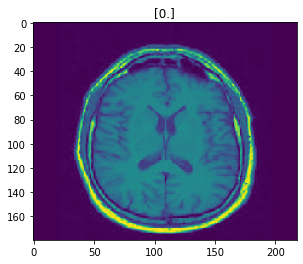

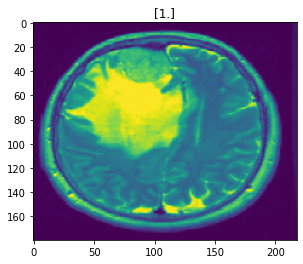

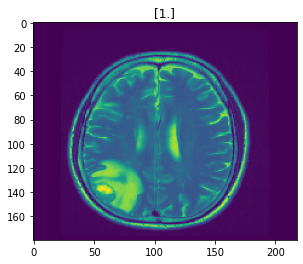

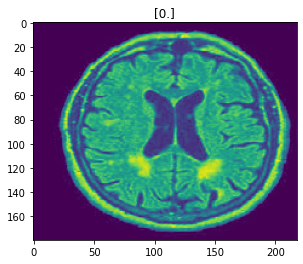

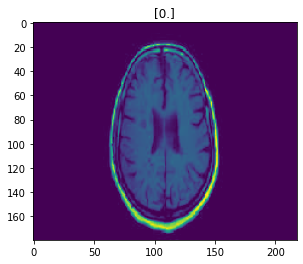

...

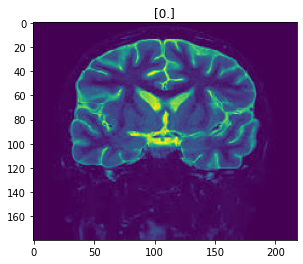

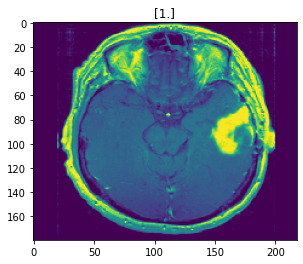

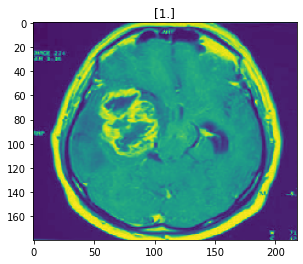

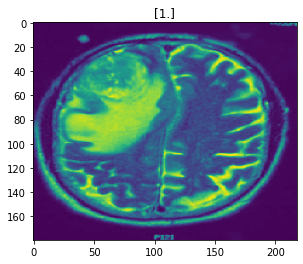

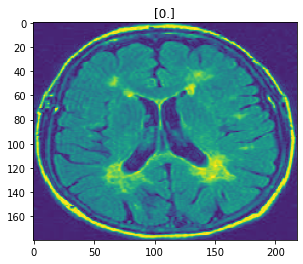

In [ ]:
x_train = []
y_train = []
for _ in range(len(train_it)):
    img, label = train_it.next()
    #print(img.shape)   #  (1,256,256,3)
    #img = np.expand_dims(img, axis=0)  # or axis=1
    #print(type(img))
    #print(np.ndim(img))
    img = np.squeeze(img, axis = -1)
    #print(img.shape)
    plt.title(label)
    #plt.text(200,220,label)
    plt.imshow(img[0])
    plt.show()
    x_train.append(img[0])
    y_train.append(label)

In [ ]:
print(x_train)
print(y_train)

/usr/local/lib/python3.7/dist-packages/matplotlib/text.py:1165: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if s != self._text:


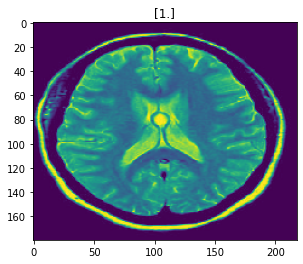

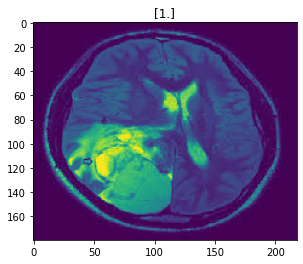

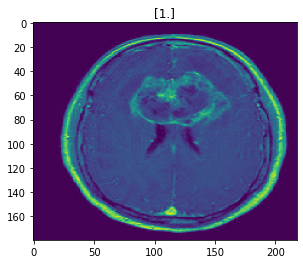

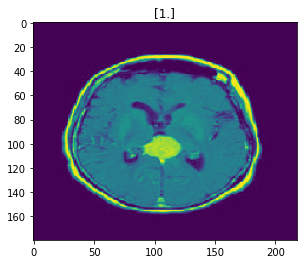

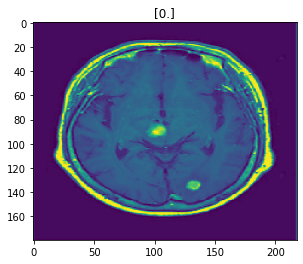

...

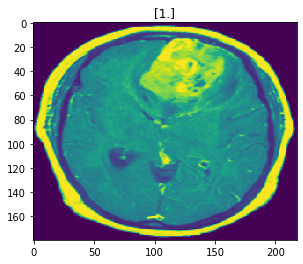

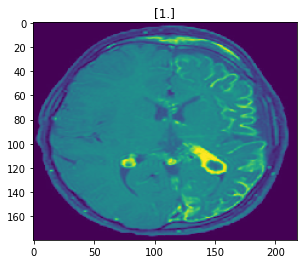

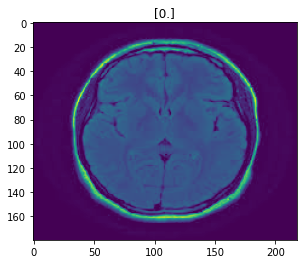

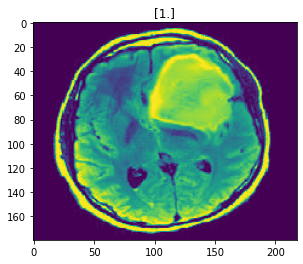

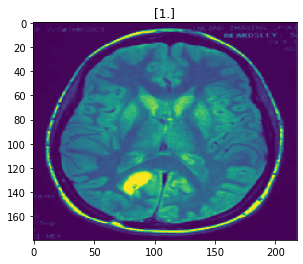

In [ ]:
x_test = []
y_test = []
for _ in range(len(test_it)):
    img, label = test_it.next()
    #print(img.shape)   #  (1,256,256,3)
    #img = np.expand_dims(img, axis=0)  # or axis=1
    #print(type(img))
    #print(np.ndim(img))
    img = np.squeeze(img, axis = -1)
    #print(img.shape)
    plt.title(label)
    #plt.text(200,220,label)
    plt.imshow(img[0])
    plt.show()
    x_test.append(img[0])
    y_test.append(label)

In [ ]:
print(x_test)
print(y_test)

/usr/local/lib/python3.7/dist-packages/matplotlib/text.py:1165: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if s != self._text:


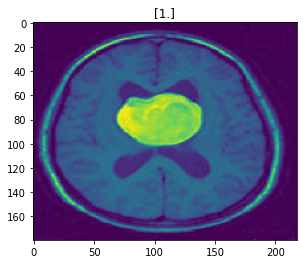

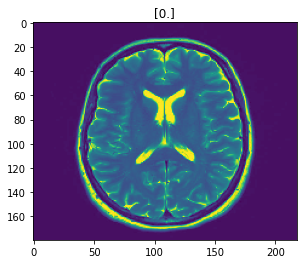

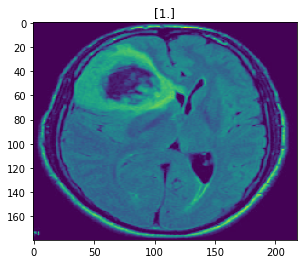

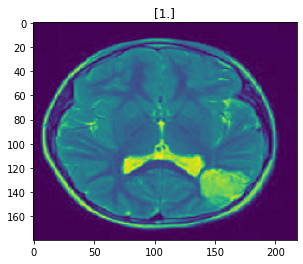

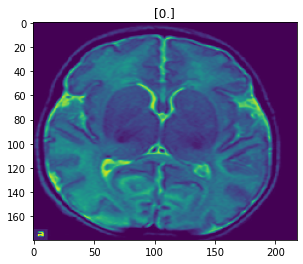

...

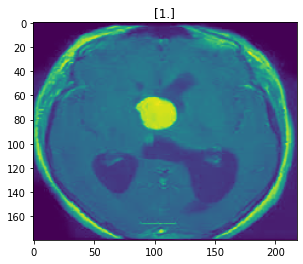

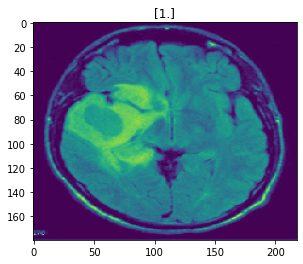

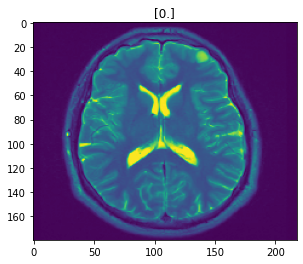

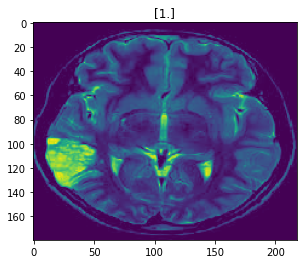

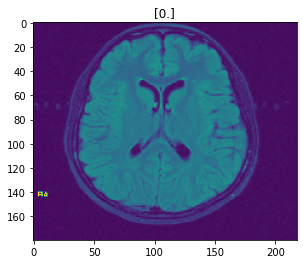

In [ ]:
x_val = []
y_val = []
for _ in range(len(val_it)):
    img, label = val_it.next()
    #print(img.shape)   #  (1,256,256,3)
    #img = np.expand_dims(img, axis=0)  # or axis=1
    #print(type(img))
    #print(np.ndim(img))
    img = np.squeeze(img, axis = -1)
    #print(img.shape)
    plt.title(label)
    #plt.text(200,220,label)
    plt.imshow(img[0])
    plt.show()
    x_val.append(img[0])
    y_val.append(label)

In [ ]:
print(x_val)
print(y_val)

In [ ]:
import keras
from keras.models import Sequential
from keras.layers import Dense, Conv2D , MaxPool2D , Flatten , Dropout 
#from keras.preprocessing.image import ImageDataGenerator

import tensorflow 
from tensorflow.keras.optimizers import Adam


In [ ]:
x_train = np.expand_dims(x_train, axis = 3)
print(np.shape(x_train))

(108, 180, 218, 1)


In [ ]:
x_test = np.expand_dims(x_test, axis = 3)
print(np.shape(x_test))

(120, 180, 218, 1)


In [ ]:
x_val = np.expand_dims(x_val, axis = 3)
print(np.shape(x_val))

(25, 180, 218, 1)


In [ ]:
print(np.shape(x_train))
print(np.shape(y_train))
print(np.shape(x_test))
print(np.shape(y_test))



(108, 180, 218, 1)
(108, 1)
(120, 180, 218, 1)
(120, 1)


In [ ]:
y_train = np.asarray(y_train).astype('float32').reshape((-1,1))
y_test = np.asarray(y_test).astype('float32').reshape((-1,1))

In [ ]:
model = Sequential()
model.add(Conv2D(64,(4,4),padding="same", activation="relu", input_shape=(180,218,1)))
model.add(MaxPool2D())

model.add(Conv2D(32, (4,4), padding="same", activation="relu"))
model.add(MaxPool2D())

model.add(Conv2D(16, (4,4), padding="same", activation="relu"))
model.add(MaxPool2D())
model.add(Dropout(0.4))

model.add(Flatten())
model.add(Dense(64,activation="relu"))
model.add(Dense(1, activation="sigmoid"))

model.summary()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_9 (Conv2D)            (None, 180, 218, 64)      1088      
_________________________________________________________________
max_pooling2d_9 (MaxPooling2 (None, 90, 109, 64)       0         
_________________________________________________________________
conv2d_10 (Conv2D)           (None, 90, 109, 32)       32800     
_________________________________________________________________
max_pooling2d_10 (MaxPooling (None, 45, 54, 32)        0         
_________________________________________________________________
conv2d_11 (Conv2D)           (None, 45, 54, 16)        8208      
_________________________________________________________________
max_pooling2d_11 (MaxPooling (None, 22, 27, 16)        0         
_________________________________________________________________
dropout_3 (Dropout)          (None, 22, 27, 16)       

In [ ]:
from tensorflow.keras import callbacks

class MyHistory(callbacks.Callback):
  def on_train_begin(self, logs=None):
    self.real_loss = []
  def on_epoch_end(self, epoch, logs=None):
    Ypred = self.model.predict(x_train)
    loss_value = self.model.loss(y_train,Ypred)
    self.real_loss.append(loss_value.numpy())

MyMonitor = MyHistory()

checkpointer = callbacks.ModelCheckpoint(filepath='BestModel.h5',monitor='val_accuracy',save_best_only=True)

#Monitor = model.fit(Xtrain,Ytrain,epochs=25,batch_size=25,validation_data=(Xtest,Ytest),)

opt = Adam(learning_rate=0.000002)
model.compile(optimizer = opt , loss = 'binary_crossentropy' , metrics = ['accuracy'])

array([0.], dtype=float32)

In [ ]:

x_train = np.expand_dims(x_train, axis = 3)
np.shape(x_train)
#y_train = np.expand_dims(y_train, axis = 1)
#np.shape(y_train)

(108, 180, 218, 1)

In [ ]:
x_test = np.expand_dims(x_test, axis = 3)
np.shape(x_test)

(120, 180, 218, 1)

In [ ]:
y_train = np.expand_dims(y_train, axis = 1)

In [ ]:
y_test = np.expand_dims(y_test, axis = 1)

In [ ]:
x_train = np.squeeze(x_train, axis = 1)

In [ ]:
np.shape(x_test)

(120, 180, 218, 1)

In [ ]:
np.shape(y_test)

(120, 1)

In [ ]:
y_train = np.squeeze(y_train, axis = -1)

In [ ]:
np.shape(y_train)
#np.shape(x_train)


(108, 1)

In [ ]:
np.shape(x_test)
y_test = np.expand_dims(y_test, axis = 1)
np.shape(y_train)

(108, 1, 1)

In [ ]:
np.shape(y_test)

(120, 1, 1)

In [ ]:
history = model.fit(x_train,y_train,epochs = 20 , validation_data = (x_test, y_test), callbacks=[checkpointer])

Epoch 1/20
4/4 [==============================] - 16s 4s/step - loss: 0.6892 - accuracy: 0.5463 - val_loss: 0.6900 - val_accuracy: 0.5833
Epoch 2/20
4/4 [==============================] - 16s 4s/step - loss: 0.6858 - accuracy: 0.6296 - val_loss: 0.6889 - val_accuracy: 0.6000
Epoch 3/20
4/4 [==============================] - 16s 4s/step - loss: 0.6879 - accuracy: 0.5926 - val_loss: 0.6878 - val_accuracy: 0.6667
Epoch 4/20
4/4 [==============================] - 15s 4s/step - loss: 0.6880 - accuracy: 0.5648 - val_loss: 0.6866 - val_accuracy: 0.6917
Epoch 5/20
4/4 [==============================] - 16s 4s/step - loss: 0.6865 - accuracy: 0.6204 - val_loss: 0.6856 - val_accuracy: 0.7333
Epoch 6/20
4/4 [==============================] - 16s 4s/step - loss: 0.6826 - accuracy: 0.6204 - val_loss: 0.6845 - val_accuracy: 0.7250
Epoch 7/20
4/4 [==============================] - 15s 4s/step - loss: 0.6810 - accuracy: 0.6111 - val_loss: 0.6833 - val_accuracy: 0.7083
Epoch 8/20
4/4 [==================

In [ ]:
y_train = np.asarray(y_train).astype('float32').reshape((-1,1))
y_test = np.asarray(y_test).astype('float32').reshape((-1,1))

In [ ]:
model.evaluate(x_test, y_test)

4/4 [==============================] - 3s 687ms/step - loss: 0.6703 - accuracy: 0.6417


[0.6702837347984314, 0.6416666507720947]

In [ ]:
model.evaluate(x_val,y_val)
#np.shape(x_val[0])

ValueError: ignored